<a href="https://colab.research.google.com/github/chainiqedu/chainiqedu/blob/main/terra_historic_basset_price_movements.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

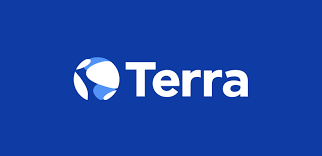  

# Terra - Historic bAssets Price Movements  

### Contact Details  

**Discord:** chainiqedu#0820  
**Twitter:** @chainiqedu  

### Overview

This notebook is a solution to the Historic bAssets Price Movements bounty on flipside crypto.  

The notebook performs an analysis of the following:  



1.   What is the most bLuna has dipped in a 30 second window in May 2021 (month of the black swan events)?
2.   How much has bLuna drifted from its Luna peg during the month of May 2021?
3.   What is the most bETH has dipped in a 30 second window during the period of Aug 13th - September 13th 2021? 
4.   How much has bETH drifted from the Ethereum price during the month long period from Aug 13th 2021 - September 13th 2021?  

## Data Sources  

All of the data sources used in this bounty are from flipside crypto. The data that is provided from the flipside queries is set to refresh every hour. The data sources used in this notebook are:  



*   terra.oracle_prices
*   uniswapv3.swaps
*   terra.msg_events

For the bETH/ETH comparison section, a month was considered similar to bLuna/Luna comparison. However values were only available for bETH starting from August 13th, so the date range used for comparing bETH and ETH was August 13th 2021 - September 13th 2021.  

In addition, instead of ETH prices being used to compare bETH, WETH was which was deemed a good enough proxy and the best bet given the data available.  
## Notes  

Each section contains a definition of the metrics used, a definition of the data sources and the key insights to takeaway from the metrics/graphs.  

## Terms Definitions  



*   Price drift - The amount that the price of one asset differs from another e.g If the price drift of bLUNA compared to Luna is +0.30, that means that the price of bLUNA is 0.30 larger than Luna
*   Peg - The asset that another asset is expected to match/hold to the value of e.g If Asset A is pegged to the value of Asset B, the expectation is the value of Asset A will be the same as Asset B (there are often deviations in practical reality but this is the theory behind it)
*   Standard Deviation: A measure of how dispered the data is in relation to the mean, a large standard deviation indicates that the dataset contains points that are far away from the mean while a low standard deviation indicates that the data points in the dataset are close to the mean
*   Rolling Mean - The mean of the last n points in the dataset e.g a weekly rolling mean would take the mean of all the data points in the last week (7 days)






In [96]:
#@title
# Python imports
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import datetime

In [97]:
#@title
# Read data from flipside crypto API for bLuna/Luna
bluna_price_history_df = pd.read_json('https://api.flipsidecrypto.com/api/v2/queries/fe8ec050-bec6-4ab4-824e-90ccd4d87e25/data/latest')
bluna_price_history_df['price_date_rounded_30_seconds'] = pd.to_datetime(bluna_price_history_df['price_date_rounded_30_seconds'], utc=True)
luna_price_history_df = pd.read_json('https://api.flipsidecrypto.com/api/v2/queries/4c117e41-eb2b-4a1a-967b-4265ac5e534d/data/latest')
luna_price_history_df['price_date_rounded_30_seconds'] = pd.to_datetime(luna_price_history_df['price_date_rounded_30_seconds'], utc=True)
# Read data from flipside crypto API for bETH/ETH
beth_price_history_df = pd.read_json('https://api.flipsidecrypto.com/api/v2/queries/ba583323-9c93-40de-949b-634391506184/data/latest')
beth_price_history_df['price_date_rounded_30_seconds'] = pd.to_datetime(beth_price_history_df['price_date_rounded_30_seconds'], utc=True)
eth_price_history_df = pd.read_json('https://api.flipsidecrypto.com/api/v2/queries/1f8d3613-33dc-41f0-a892-f9d650737858/data/latest')
eth_price_history_df['price_date_rounded_30_seconds'] = pd.to_datetime(eth_price_history_df['price_date_rounded_30_seconds'], utc=True)

## What is the most bLuna has dipped in a 30 second window in May 2021 (month of black swan events)?  

## Key Insights

*   The largest bLuna price dip was from 2021-05-16T23:50:00 with a price of 16.38 to 2021-05-16T23:50:30 with a price of 15.99. 
This represented a drop of $-0.39.   




### Metrics and Definitions

**Metric Name:** Largest bLuna Price Dip  
**Definition:** This is the largest negative difference between two prices of bLuna and Luna in a 30 second window in the month of May 2021  

### Data Sources  

The bLuna historical prices come from the terra.msg events table. The anchor oracle contract is used as the source for bLuna price. The anchor oracle contract didn't always have a price every 30 seconds so some logic was applied to approximate this as accurately as possible.  

If the seconds value for an anchor oracle price for a given minute was >= 30, then this was considered as the 30 second value. (If there were multiple values, then the value closest to 30 was chosen).   

If the seconds value for an anchor oracle price for a given minute was <30, then this was considered as the 0 second value. (Again, if there were multiple values, then the value closest to 0 was chosen).  

### Logic Example  

Using the logic explained above, let's build the 30 second intervals for the date 2021-01-05 00:00 

#### Example Dataset  

Date: 2021-01-05 00:00:7
Price: 16.21
Date:2021-01-05 00:00:15
Price: 16.34
Date:2021-01-05 00:00:32
Price: 16.56
Date:2021-01-05 00:00:47
Price: 16.54  

#### Logic Explanation

There are 2 values below 30 which are contenders for the value 2021-01-05 00:00, the one we choose is the one closest to 0.  
In this case that is the value with price 16.21   

Looking at the 2 values that are 30 or above, we would select the value 16.56 as this is closest to 30.  
This approach is then applied for every minute across the whole month of May 2021 to build the required 30 second intervals for each minute.

In [98]:
#@title
bluna_price_diff_by_time = bluna_price_history_df[['price_date_rounded_30_seconds', 'price']].diff(periods=1)
bluna_price_diff_by_time_ordered = bluna_price_diff_by_time[bluna_price_diff_by_time['price_date_rounded_30_seconds'] == '0 days 00:00:30']
bluna_largest_dip = bluna_price_diff_by_time_ordered.sort_values(by=['price', 'price_date_rounded_30_seconds']).head(1)

bluna_largest_dip_value = bluna_largest_dip['price'].values[0]
bluna_largest_dip_row_number = bluna_largest_dip.index[0]
bluna_dip = bluna_price_history_df.iloc[(bluna_largest_dip_row_number-1):(bluna_largest_dip_row_number+1)]

bluna_dip_dates_times = bluna_dip['price_date_rounded_30_seconds'].values
bluna_dip_dates_time_from = bluna_dip_dates_times[0]
bluna_dip_dates_time_to = bluna_dip_dates_times[1]

bluna_dip_prices = bluna_dip['price'].values
bluna_dip_price_from = bluna_dip_prices[0]
bluna_dip_price_to = bluna_dip_prices[1]

print("The largest bLuna price dip was from {} with a price of {:.2f} to {} with a price of {:.2f}. \nThis represents a drop of ${:.2f}".format(
    bluna_dip_dates_time_from, bluna_dip_price_from, bluna_dip_dates_time_to, bluna_dip_price_to, bluna_largest_dip_value))

The largest bLuna price dip was from 2021-05-16T23:50:00.000000000 with a price of 16.38 to 2021-05-16T23:50:30.000000000 with a price of 15.99. 
This represents a drop of $-0.39


## How much has bLuna drifted from its Luna peg during the month of May 2021?  

## Key Insights  



*   bLuna and Luna prices follow each other closely throughout May - this is indicated by the bLuna vs Luna Price Time Series Figure (zoom in one the graph to see the differences, they are small)
*   This is further supported by looking at the min, max and mean price differences of bLuna and Luna - the average difference tends to even out around 0, the min value is is -0.3916 (meaning that max amount bLuna is larger than Luna is ~0.39) and the max value is 0.24 (meaning that the max amount that Luna is larger than bLuna is ~0.24)
*   This is positive as bLuna is intended to be pegged to the value of Luna and while a perfect peg is what is aimed for these values are not terrible - one caveat is that these small values could become significant if exchanging Luna/bLuna for large sums e.g 100K/1M+ tokens
*   The bLuna vs Luna price difference for 30 second intervals is quite a noisy time series with some large spikes across the month indicating the times where the price difference was largest
*   The bLuna vs Luna rolling 5 minute mean and standard devitation price difference shows that from:

>>   May 1st to May 14th the rolling mean/standard deviation price difference is smallest with some outlier spikes  

>>   May 14th to May 26th the price difference seems to increase indicated by an increase in the height of the time series lines 

>>  May 26th onwards the price difference starts to decrease again but still larger than the initial rolling mean price difference from May 1st to May 14th  

*   To summarise this, there is not a constant price difference and at different points of the month bLuna and Luna can be closer together (May 1st to May 14th) or further apart (May 14th to May 26th)





### Metrics and Definitions

**Metric Name:** bLuna vs Luna Price Time Series Figure  
**Definition:** Plots the price history of bLuna vs Luna for every 30 second intervals for May 2021  

**Metric Name:** bLuna vs Luna Price Difference  
**Definition:** Plots the price difference (Luna - bLuna) for every 30 second interval for May 2021  

**Metric Name:** bLuna vs Luna Price Difference Rolling Mean (5 Minute Window) Price Difference  
**Definition:** Plots the rolling mean price difference (Luna - bLuna) for every 5 minute interval for May 2021 (For every 10 data points (1 minute = 2x 30 second data points) find the mean and plot it)  

**Metric Name:** bLuna vs Luna Price Difference Rolling Standard Deviation (5 Minute Window) Price Difference  
**Definition:** Plots the rolling standard deviation price difference (Luna - bLuna) for every 5 minute interval for May 2021 (For every 10 data points (1 minute = 2x 30 second data points) find the standard deviation and plot it)  

### Data Sources  

The Luna prices come from the terra.oracle_prices dataset and the bLuna prices come from the terra.msg_events where the price of bLuna is pulled from the anchor oracle contract when getting a price for asset terra1kc87mu460fwkqte29rquh4hc20m54fxwtsx7gp

In [99]:
#@title
# Create dataframe of 30 second periods from 1st May 2021 to 31st May 2021
date_time_periods = []
start_date = datetime.datetime(2021,5,1, 0,0,0)
end_date = datetime.datetime(2021,6,1,0,0,0)
delta = datetime.timedelta(seconds=30)

while start_date < end_date:
  date_time_periods.append(start_date)
  start_date += delta

date_time_periods_df = pd.DataFrame(date_time_periods, columns=['price_date_rounded_30_seconds'])
date_time_periods_df = pd.to_datetime(date_time_periods_df['price_date_rounded_30_seconds'], utc=True)

In [100]:
#@title
# Create dataframes with dates and prices - there will be some missing data and this will allow us to see the complete set of dates and what periods have prices missing
date_bluna_df = pd.merge(date_time_periods_df, bluna_price_history_df, on='price_date_rounded_30_seconds',how='left')
date_luna_df = pd.merge(date_time_periods_df, luna_price_history_df, on='price_date_rounded_30_seconds', how='left')

In [101]:
#@title
# Union the dataframes to enable plotting to be done on the same graph
frames = [date_bluna_df, date_luna_df]
luna_bluna_price_history_df = pd.concat(frames)

In [102]:
#@title
# Only plot rows that are not null
luna_bluna_price_history_df = luna_bluna_price_history_df.sort_values(by=['price_date_rounded_30_seconds', 'symbol'], ascending=True)
cleaned_luna_bluna_price_history_df = luna_bluna_price_history_df[luna_bluna_price_history_df['price'].notnull()]

In [103]:
#@title
# Inner Join - Only consider rows that have both prices for bLUNA and LUNA
# This dataframe will be used to subtract the price of LUNA and bLUNA to determine the differences
cleaned_inner_bluna_df = date_bluna_df[date_bluna_df['price'].notnull()]
cleaned_inner_luna_df = date_luna_df[date_luna_df['price'].notnull()]
inner_bluna_luna_df = pd.merge(cleaned_inner_bluna_df, cleaned_inner_luna_df, on='price_date_rounded_30_seconds', how='inner')

# bLuna vs Luna Price Time Series Figure  

A time series line chart plotting the values of bLuna and Luna prices in 30 second intervals through May 2021  

In [124]:
#@title
import plotly.express as px

fig = px.line(cleaned_luna_bluna_price_history_df, x="price_date_rounded_30_seconds", y="price", color='symbol')
fig.show()

In [105]:
#@title
inner_bluna_luna_df = pd.merge(cleaned_inner_bluna_df, cleaned_inner_luna_df, on='price_date_rounded_30_seconds', how='inner', suffixes=('_bluna', '_luna'))
inner_bluna_luna_df['price_diff'] = inner_bluna_luna_df['price_luna'] - inner_bluna_luna_df['price_bluna']

## bLuna vs Luna Price Difference May 2021 (30 Second Intervals)

In [106]:
#@title
# price difference dataframe
bluna_luna_price_diff_df = inner_bluna_luna_df
max_price_diff = bluna_luna_price_diff_df['price_diff'].max()
min_price_diff = bluna_luna_price_diff_df['price_diff'].min()
avg_price_diff = bluna_luna_price_diff_df['price_diff'].mean()
bluna_luna_price_diff_df['rolling_mean_5_minutes'] = inner_bluna_luna_df['price_diff'].rolling(window = 10, center = False).mean()
bluna_luna_price_diff_df['rolling_std_dev_5_minutes'] = inner_bluna_luna_df['price_diff'].rolling(window = 10, center = False).std()

In [107]:
#@title
print("Max price diff: {:.4f}".format(max_price_diff))
print("Min price diff: {:.4f}".format(min_price_diff))
print("Avg price diff: {:.4f}".format(avg_price_diff))

Max price diff: 0.2413
Min price diff: -0.3916
Avg price diff: -0.0002


In [108]:
#@title
fig = px.line(inner_bluna_luna_df, x="price_date_rounded_30_seconds", y="price_diff", 
              title="bLuna vs Luna Price Difference May 2021 (30 Second Intervals)")
fig.show()

## bLuna vs Luna Price Difference Rolling Mean (5 Minute Window) Price Difference

In [109]:
#@title
fig = px.line(inner_bluna_luna_df, x="price_date_rounded_30_seconds", y="rolling_mean_5_minutes",
              title="bLuna vs Luna Price Difference Rolling Mean May 2021 (5 minute intervals)")
fig.show()

##  bLuna vs Luna Price Difference Rolling Standard Deviation (5 Minute Window) Price Difference

In [110]:
#@title
fig = px.line(inner_bluna_luna_df, x="price_date_rounded_30_seconds", y="rolling_std_dev_5_minutes",
              title="bLuna vs Luna Price Difference Rolling Standard Deviation May 2021 (5 minute intervals)")
fig.show()

## What is the most bETH has dipped in a 30 second window during the period of Aug 13th - September 13th 2021?

## Key Insights

*   The largest bEth price dip was from 2021-09-07T14:50:30.000000000 with a price of 3635.07 to 2021-09-07T15:23:00.000000000 with a price of 3300.12. This represents a drop of $-334.95  
*   A key point to note in this though is that the resolution of WETH price (which we are using a proxy for the price of ETH) is probably too small for 30 second intervals - this is indicated by the square shapes on the graph (with more time I would probably go back and select a more appropriate resolution for this task)



### Metrics and Definitions

**Metric Name:** Largest bETH Price Dip  
**Definition:** This is the largest negative difference between two prices of bETH and ETH in a 30 second window in the time period of August 13 2021 - September 13th 2021 

In [111]:
beth_price_diff_by_time = beth_price_history_df[['price_date_rounded_30_seconds', 'price']].diff(periods=1)
beth_price_diff_by_time_ordered = beth_price_diff_by_time[beth_price_diff_by_time['price_date_rounded_30_seconds'] == '0 days 00:00:30']
beth_largest_dip = beth_price_diff_by_time.sort_values(by=['price', 'price_date_rounded_30_seconds']).head(1)

beth_largest_dip_value = beth_largest_dip['price'].values[0]
beth_largest_dip_row_number = beth_largest_dip.index[0]
beth_dip = beth_price_history_df.iloc[(beth_largest_dip_row_number-1):(beth_largest_dip_row_number+1)]

beth_dip_dates_times = beth_dip['price_date_rounded_30_seconds'].values
beth_dip_dates_time_from = beth_dip_dates_times[0]
beth_dip_dates_time_to = beth_dip_dates_times[1]

beth_dip_prices = beth_dip['price'].values
beth_dip_price_from = beth_dip_prices[0]
beth_dip_price_to = beth_dip_prices[1]

print("The largest bEth price dip was from {} with a price of {:.2f} to {} with a price of {:.2f}. \nThis represents a drop of ${:.2f}".format(
    beth_dip_dates_time_from, beth_dip_price_from, beth_dip_dates_time_to, beth_dip_price_to, beth_largest_dip_value))

The largest bEth price dip was from 2021-09-07T14:50:30.000000000 with a price of 3635.07 to 2021-09-07T15:23:00.000000000 with a price of 3300.12. 
This represents a drop of $-334.95


## How much has bETH drifted from the Ethereum price during the period of Aug 13th - September 13th 2021?

## Key Insights

*   bETH and WETH prices tend to follow each other on the bETH vs Eth Price Time Series Figure difficult to read too much into given limited resolution for WETH prices
*   The bETH vs Eth price difference for 30 second intervals is quite a noisy time series fluctuating with a lot of the price differences being captured between 200 to -200
*   There is a few large spikes in price difference around 400 on September 7th where the value of ETH greatly exceeds that of bETH 
*   The bETH vs Eth rolling 5 minute mean and standard devitation price difference shows that from:

>>   Aug 13th to Aug 30 the rolling mean price difference is smallest and relatively consistent with some outlier spikes  

>>   Aug 30th to onwards the price differences seem to get more noisy and there are large swings of price difference on September 7th in particular

>>  The standard deviation remains relatively constant throughout with some larger outlier spikes across the time series 
 
*   To summarise this, there is not a constant price difference and there are some particularly large swings of price difference between bETH and ETH
*   These results should be taken lightly as indicated before that the resolution of the ETH price is not as good as it should be however the ultimate goal would be for bETH and ETH to remain as closer together as possible - large swings as we have seen in this data can result in large effects for users wishing to convert between the two assets

### Metrics and Definitions

**Metric Name:** bETH vs Eth Price Time Series Figure  
**Definition:** Plots the price history of bETH vs Eth for every 30 second intervals for August 13th 2021 - September 13th 2021 

**Metric Name:** bETH vs Eth Price Difference  
**Definition:** Plots the price difference (Eth - bETH) for every 30 second interval for August 13th 2021 - September 13th 2021  

**Metric Name:** bETH vs Eth Price Difference Rolling Mean (5 Minute Window) Price Difference  
**Definition:** Plots the rolling mean price difference (Eth - bETH) for every 5 minute interval for August 13th 2021 - September 13th 2021  (For every 10 data points (1 minute = 2x 30 second data points) find the mean and plot it)  

**Metric Name:** bETH vs Eth Price Difference Rolling Standard Deviation (5 Minute Window) Price Difference  
**Definition:** Plots the rolling standard deviation price difference (Eth - bETH) for every 5 minute interval for August 13th 2021 - September 13th 2021  (For every 10 data points (1 minute = 2x 30 second data points) find the standard deviation and plot it) 



### Data Sources  

The reason that the 13th August 2021 to 13th September 2021 is chosen is due to this being the first month that prices are available for bETH to be able to compare.  

The data sources used for bETH is the terra.msg_events dataset using the anchor oracle contract for price feeds looking for the asset terra1dzhzukyezv0etz22ud940z7adyv7xgcjkahuun. 

The datasources to calculate the ethereum price is using uniswapv3.swaps data where we can get the WETH price from the swaps that occur. The WETH price is used as a good proxy for the ETH price. The other sources of ETH are not granular enough to consider 30 second window intervals.  

In [112]:
#@title
# Create dataframe of 30 second periods from 13th August to 13th September 2021
start_date = datetime.datetime(2021,8,13, 19,49,0)
end_date = datetime.datetime(2021,9,13,19,49,0)
delta = datetime.timedelta(seconds=30)

while start_date < end_date:
  date_time_periods.append(start_date)
  start_date += delta

date_time_periods_df = pd.DataFrame(date_time_periods, columns=['price_date_rounded_30_seconds'])
date_time_periods_df = pd.to_datetime(date_time_periods_df['price_date_rounded_30_seconds'], utc=True)

In [113]:
#@title
# Create dataframes with dates and prices - there will be some missing data and this will allow us to see the complete set of dates and what periods have prices missing
date_beth_df = pd.merge(date_time_periods_df, beth_price_history_df, on='price_date_rounded_30_seconds',how='left')
date_eth_df = pd.merge(date_time_periods_df, eth_price_history_df, on='price_date_rounded_30_seconds', how='left')

In [114]:
#@title
# Union the dataframes to enable plotting to be done on the same graph
frames = [date_beth_df, date_eth_df]
eth_beth_price_history_df = pd.concat(frames)

In [115]:
#@title
# Only plot rows that are not null
eth_beth_price_history_df = eth_beth_price_history_df.sort_values(by=['price_date_rounded_30_seconds', 'symbol'], ascending=True)
cleaned_eth_beth_price_history_df = eth_beth_price_history_df[eth_beth_price_history_df['price'].notnull()]

In [116]:
#@title
# Inner Join - Only consider rows that have both prices for bLUNA and LUNA
# This dataframe will be used to subtract the price of LUNA and bLUNA to determine the differences
cleaned_inner_beth_df = date_beth_df[date_beth_df['price'].notnull()]
cleaned_inner_eth_df = date_eth_df[date_eth_df['price'].notnull()]
inner_beth_eth_df = pd.merge(cleaned_inner_beth_df, cleaned_inner_eth_df, on='price_date_rounded_30_seconds', how='inner')

# bEth vs Eth Price Time Series Figure  

A time series line chart plotting the values of bEth and Eth prices in 30 second intervals through 13th August 2021 - 13th September 2021

In [117]:
#@title
import plotly.express as px

fig = px.line(cleaned_eth_beth_price_history_df, x="price_date_rounded_30_seconds", y="price", color='symbol')
fig.show()

In [118]:
#@title
inner_beth_eth_df = pd.merge(cleaned_inner_beth_df, cleaned_inner_eth_df, on='price_date_rounded_30_seconds', how='inner', suffixes=('_beth', '_eth'))
inner_beth_eth_df['price_diff'] = inner_beth_eth_df['price_eth'] - inner_beth_eth_df['price_beth']

## bEth vs Eth Price Difference August 13th 2021 - September 13th 2021 (30 Second Intervals)

In [119]:
#@title
# price difference dataframe
beth_eth_price_diff_df = inner_beth_eth_df
max_price_diff = beth_eth_price_diff_df['price_diff'].max()
min_price_diff = beth_eth_price_diff_df['price_diff'].min()
avg_price_diff = beth_eth_price_diff_df['price_diff'].mean()
beth_eth_price_diff_df['rolling_mean_5_minutes'] = inner_beth_eth_df['price_diff'].rolling(window = 10, center = False).mean()
beth_eth_price_diff_df['rolling_std_dev_5_minutes'] = inner_beth_eth_df['price_diff'].rolling(window = 10, center = False).std()

In [120]:
#@title
print("Max price diff: {:.4f}".format(max_price_diff))
print("Min price diff: {:.4f}".format(min_price_diff))
print("Avg price diff: {:.4f}".format(avg_price_diff))

Max price diff: 396.1119
Min price diff: -218.8228
Avg price diff: 18.1258


In [121]:
#@title
fig = px.line(inner_beth_eth_df, x="price_date_rounded_30_seconds", y="price_diff", 
              title="bEth vs Eth Price Difference August 13th 2021 - September 13th 2021 (30 Second Intervals)")
fig.show()

## bEth vs Eth Price Difference Rolling Mean (5 Minute Window) Price Difference

In [122]:
#@title
fig = px.line(inner_beth_eth_df, x="price_date_rounded_30_seconds", y="rolling_mean_5_minutes",
              title="bEth vs Eth Price Difference Rolling Mean August 13th 2021 - September 13th 2021 (5 minute intervals)")
fig.show()

##  bEth vs Eth Price Difference Rolling Standard Deviation (5 Minute Window) Price Difference

In [123]:
#@title
fig = px.line(inner_beth_eth_df, x="price_date_rounded_30_seconds", y="rolling_std_dev_5_minutes",
              title="bEth vs Eth Price Difference Rolling Standard Deviation August 13th 2021 - September 13th 2021 (5 minute intervals)")
fig.show()